In [1]:
COUNT = 500
TRAIN = '/kaggle/input/american-sign-language-silhouettes/gestures'

We want to use image embeddings for EDA and classification, so let's add some code that will get them using ResNeXt with no fine tuning.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth
100%|██████████| 95.8M/95.8M [00:01<00:00, 85.5MB/s]


Next let's load up a sample of our data. We have a lot of classes, so let's take a relatively small sample of each class.

In [3]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from PIL import Image

THUMBNAIL_SIZE = (64, 64)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'] )
        for index, input_file in enumerate(list(iglob(pathname=arg))) if index < COUNT]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*') }
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
print('done in {}'.format(arrow.now() - time_start))

encoded 500 rows of 7  in 0:01:12.020962
encoded 500 rows of 17  in 0:01:08.776351
encoded 500 rows of 19  in 0:01:09.129707
encoded 500 rows of 22  in 0:01:09.287139
encoded 500 rows of 2  in 0:01:09.016868
encoded 500 rows of 23  in 0:01:09.812628
encoded 500 rows of 10  in 0:01:08.027609
encoded 500 rows of 5  in 0:01:08.631011
encoded 500 rows of 20  in 0:01:08.863160
encoded 500 rows of 25  in 0:01:10.414823
encoded 500 rows of 8  in 0:01:09.702199
encoded 500 rows of 12  in 0:01:09.690206
encoded 500 rows of 0  in 0:01:08.617723
encoded 500 rows of 18  in 0:01:08.885834
encoded 500 rows of 16  in 0:01:08.688586
encoded 500 rows of 13  in 0:01:08.903215
encoded 500 rows of 26  in 0:01:08.004905
encoded 500 rows of 15  in 0:01:08.355373
encoded 500 rows of 3  in 0:01:07.968058
encoded 500 rows of 1  in 0:01:08.724226
encoded 500 rows of 14  in 0:01:09.359427
encoded 500 rows of 4  in 0:01:07.778726
encoded 500 rows of 9  in 0:01:08.381355
encoded 500 rows of 21  in 0:01:09.067078
e

Next let's add x/y coordinates using TSNE.

In [4]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 13500 samples in 0.084s...
[t-SNE] Computed neighbors for 13500 samples in 13.361s...
[t-SNE] Computed conditional probabilities for sample 1000 / 13500
[t-SNE] Computed conditional probabilities for sample 2000 / 13500
[t-SNE] Computed conditional probabilities for sample 3000 / 13500
[t-SNE] Computed conditional probabilities for sample 4000 / 13500
[t-SNE] Computed conditional probabilities for sample 5000 / 13500
[t-SNE] Computed conditional probabilities for sample 6000 / 13500
[t-SNE] Computed conditional probabilities for sample 7000 / 13500
[t-SNE] Computed conditional probabilities for sample 8000 / 13500
[t-SNE] Computed conditional probabilities for sample 9000 / 13500
[t-SNE] Computed conditional probabilities for sample 10000 / 13500
[t-SNE] Computed conditional probabilities for sample 11000 / 13500
[t-SNE] Computed conditional probabilities for sample 12000 / 13500
[t-SNE] Computed conditional probabilities for sa

Now we're ready to plot.

In [5]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']])
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: ASL silhouettes', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=6, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? Surprisingly, most of our classes are in tight, distinct clusters. We should be optimistic about our model accuracy. Let's build a model and see what we get.

In [6]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(train_df['value'].apply(pd.Series), train_df['tag'], test_size=0.25, random_state=2025, stratify=train_df['tag'])
logreg = LogisticRegression(max_iter=5000, tol=1e-12).fit(X_train, y_train)
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=y_test, y_pred=logreg.predict(X=X_test))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=y_test, y_pred=logreg.predict(X=X_test))))
print(classification_report(y_true=y_test, y_pred=logreg.predict(X=X_test)))

model fit in 760 iterations
accuracy: 0.9970
f1: 0.9970
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       125
           1       1.00      0.98      0.99       125
          10       1.00      1.00      1.00       125
          11       0.99      1.00      1.00       125
          12       0.98      1.00      0.99       125
          13       1.00      0.98      0.99       125
          14       1.00      1.00      1.00       125
          15       1.00      1.00      1.00       125
          16       1.00      1.00      1.00       125
          17       1.00      1.00      1.00       125
          18       1.00      1.00      1.00       125
          19       0.98      1.00      0.99       125
           2       1.00      1.00      1.00       125
          20       0.99      0.97      0.98       125
          21       0.98      1.00      0.99       125
          22       1.00      1.00      1.00       125
          23       1.00  

An f1 greater than 0.98 for almost no effort is kind of surprising. Let's take a look at our model probabilities.

<Axes: xlabel='probability', ylabel='Count'>

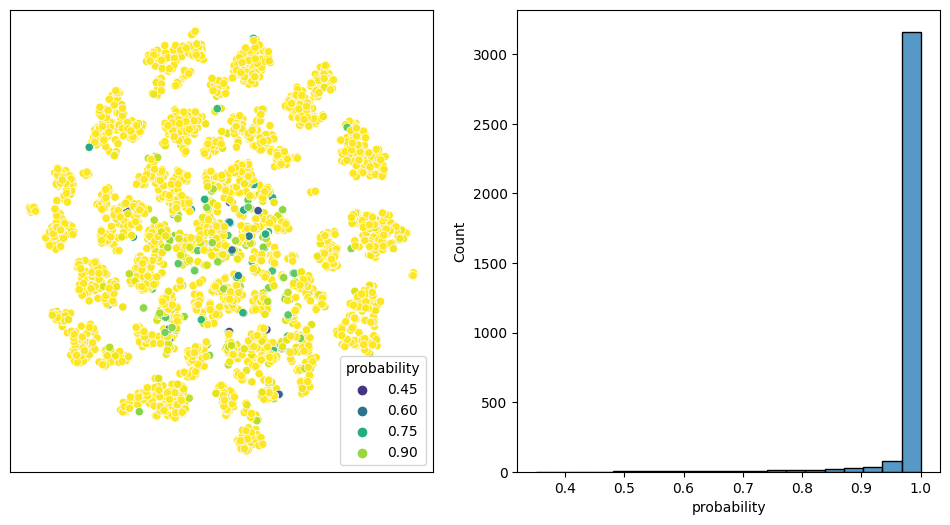

In [7]:
import matplotlib.pyplot as plt
import warnings
from seaborn import histplot
from seaborn import scatterplot

warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn')

plot_df = train_df.iloc[X_test.index][['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=X_test), axis=1)

plt, ax = plt.subplots(ncols=2, figsize=(12, 6))
scatterplot(ax=ax[0], data=plot_df, x='x', y='y', hue='probability', palette='viridis')
ax[0].set(xlabel=None) 
ax[0].set(ylabel=None)
ax[0].set(xticklabels=[])
ax[0].set(yticklabels=[])
ax[0].tick_params(axis='both', which='both', length=0)
histplot(ax=ax[1], data=plot_df, x='probability', bins=20)

Our model probabilities are mostly quite high, except for the overlapping TSNE clusters.